In [49]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

%matplotlib inline
%config InlineBackend.figure_format='retina'
pd.set_option('display.max_columns', 999)
pd.set_option('display.max_rows', 999)

In [5]:
df = pd.read_csv('./COVID19 Hackathon Dataset.csv')
df.head()

,Date,Continent,Countries,New_Cases,New_Deaths,Total_Cases,Total_Deaths,Weekly_Cases,Weekly_Deaths,Population_Density,Fertility_Rate,GDP_PPP,Corruption,Government_Effectiveness,Political_Stability,Rule_of_Law,Government_Healthcare_Spend,Urban_Population,Smoking_Prevalence,Tourism,Women_In_Parliament,Obesity_Rate,RunTot_New_Cases,RunTot_New_Deaths,Country,Country Code,Year,Diabetes Prevelance % of Population 20-79,Labour Force Total,Population,Population Aged 65 and above % of Total,Urban Population,Death Rate Per 1000 (2017),"PM2.5 air pollution, mean annual exposure (micrograms per cubic meter) (2017)","PM2.5 air pollution, population exposed to levels exceeding WHO guideline value (% of total) (2017)",Hospital Beds Year,Hospital Beds Per 1000 People
0,2019-12-31,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
1,2020-01-01,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
2,2020-01-02,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
3,2020-01-03,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
4,2020-01-04,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5


In [8]:
df.rename(
    columns={'PM2.5 air pollution, mean annual exposure (micrograms per cubic meter) (2017)':'Pollution mean exposure', 
             'PM2.5 air pollution, population exposed to levels exceeding WHO guideline value (% of total) (2017)':'Pop exposed to high pollution'},
    inplace=True)

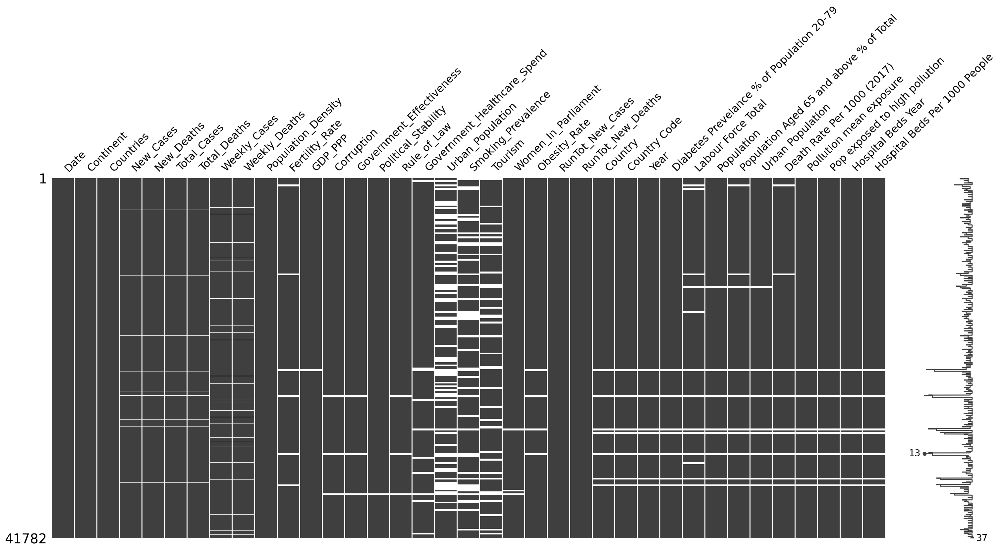

In [9]:
import missingno as msno
msno.matrix(df)

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41782 entries, 0 to 41781
Data columns (total 37 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   Date                                       41782 non-null  object 
 1   Continent                                  41782 non-null  object 
 2   Countries                                  41782 non-null  object 
 3   New_Cases                                  41506 non-null  float64
 4   New_Deaths                                 41506 non-null  float64
 5   Total_Cases                                41506 non-null  float64
 6   Total_Deaths                               41506 non-null  float64
 7   Weekly_Cases                               40840 non-null  float64
 8   Weekly_Deaths                              40840 non-null  float64
 9   Population_Density                         41782 non-null  float64
 10  Fertility_Rate        

In [40]:
gb = df.groupby('Countries')
databycountry = [gb.get_group(x) for x in gb.groups]

In [50]:
databycountry[0].head(100)

,Date,Continent,Countries,New_Cases,New_Deaths,Total_Cases,Total_Deaths,Weekly_Cases,Weekly_Deaths,Population_Density,Fertility_Rate,GDP_PPP,Corruption,Government_Effectiveness,Political_Stability,Rule_of_Law,Government_Healthcare_Spend,Urban_Population,Smoking_Prevalence,Tourism,Women_In_Parliament,Obesity_Rate,RunTot_New_Cases,RunTot_New_Deaths,Country,Country Code,Year,Diabetes Prevelance % of Population 20-79,Labour Force Total,Population,Population Aged 65 and above % of Total,Urban Population,Death Rate Per 1000 (2017),Pollution mean exposure,Pop exposed to high pollution,Hospital Beds Year,Hospital Beds Per 1000 People
0,2019-12-31,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
1,2020-01-01,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
2,2020-01-02,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
3,2020-01-03,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
4,2020-01-04,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
5,2020-01-05,Asia,Afghanistan,0.0,0.0,0.0,0.0,NaN,NaN,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
6,2020-01-06,Asia,Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
7,2020-01-07,Asia,Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
8,2020-01-08,Asia,Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
9,2020-01-09,Asia,Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,0,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5


In [45]:
databycountry[0][databycountry[0]['New_Cases'].isnull()]

,Date,Continent,Countries,New_Cases,New_Deaths,Total_Cases,Total_Deaths,Weekly_Cases,Weekly_Deaths,Population_Density,Fertility_Rate,GDP_PPP,Corruption,Government_Effectiveness,Political_Stability,Rule_of_Law,Government_Healthcare_Spend,Urban_Population,Smoking_Prevalence,Tourism,Women_In_Parliament,Obesity_Rate,RunTot_New_Cases,RunTot_New_Deaths,Country,Country Code,Year,Diabetes Prevelance % of Population 20-79,Labour Force Total,Population,Population Aged 65 and above % of Total,Urban Population,Death Rate Per 1000 (2017),Pollution mean exposure,Pop exposed to high pollution,Hospital Beds Year,Hospital Beds Per 1000 People
63,2020-03-03,Asia,Afghanistan,NaN,NaN,NaN,NaN,0.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,1,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
64,2020-03-04,Asia,Afghanistan,NaN,NaN,NaN,NaN,0.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,1,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
65,2020-03-05,Asia,Afghanistan,NaN,NaN,NaN,NaN,0.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,1,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
66,2020-03-06,Asia,Afghanistan,NaN,NaN,NaN,NaN,0.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,1,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
67,2020-03-07,Asia,Afghanistan,NaN,NaN,NaN,NaN,0.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,1,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
69,2020-03-09,Asia,Afghanistan,NaN,NaN,NaN,NaN,3.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,4,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
70,2020-03-10,Asia,Afghanistan,NaN,NaN,NaN,NaN,3.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,4,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
72,2020-03-12,Asia,Afghanistan,NaN,NaN,NaN,NaN,6.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,7,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
73,2020-03-13,Asia,Afghanistan,NaN,NaN,NaN,NaN,6.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,7,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5
74,2020-03-14,Asia,Afghanistan,NaN,NaN,NaN,NaN,6.0,0.0,59.6,4.04,1800.0,-1.496648,-1.457285,-2.74673,-1.668478,0.050958,0.108,NaN,NaN,0.278689,0.055,7,0,Afghanistan,AFG,2019.0,9.2,10699797.0,38041754.0,2.615794,9797273.0,6.575,56.910808,100.0,2015.0,0.5


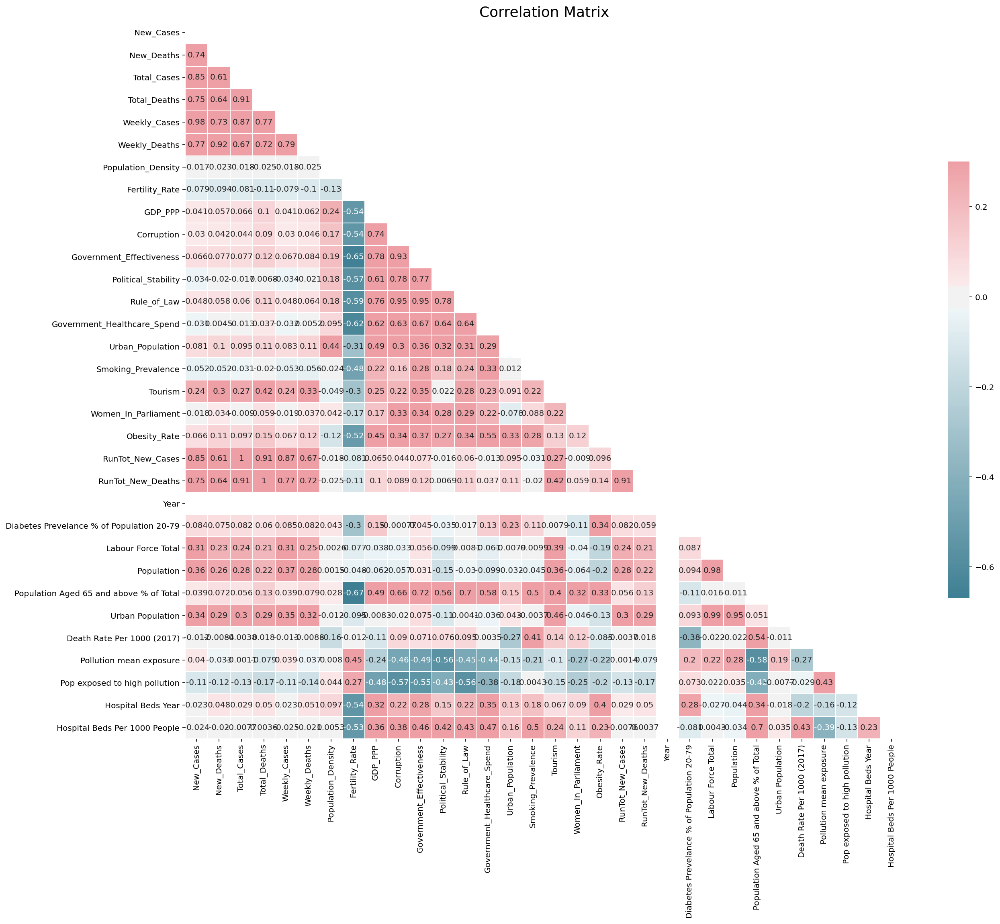

In [34]:
corr = df.corr()
mask = np.triu(np.ones_like(corr, dtype=np.bool))
f, ax = plt.subplots(figsize=(20, 20))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
plt.title('Correlation Matrix', fontsize=18)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
plt.show()

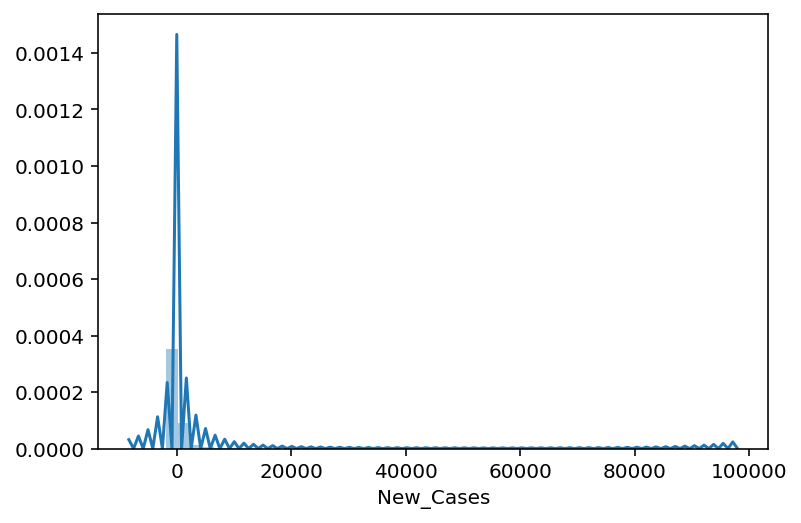

In [27]:
sns.distplot(df['New_Cases'])

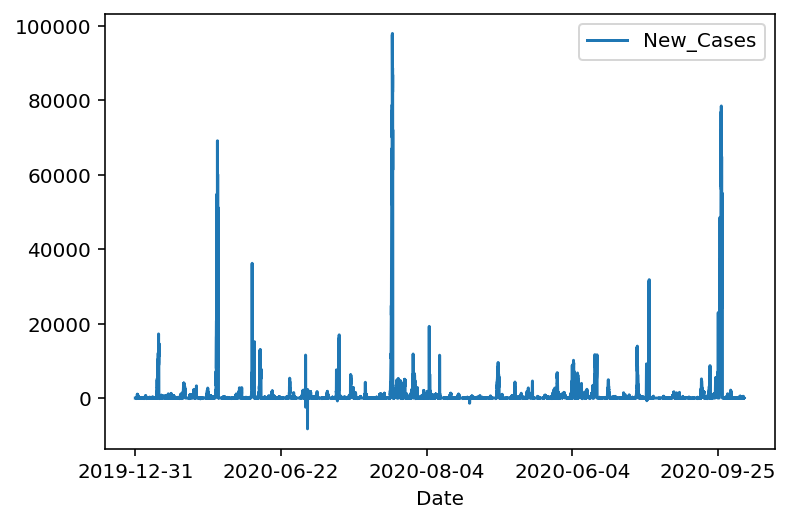

In [13]:
df[['Date','New_Cases']].plot(x='Date')

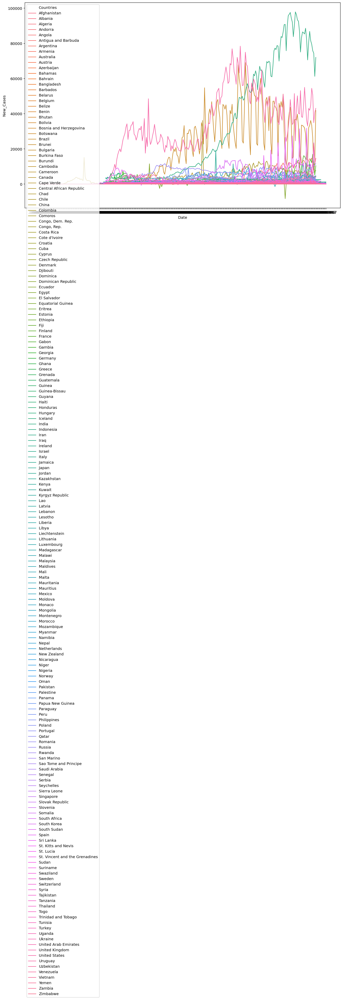

In [25]:
# Clearly, this is too much info for one graph with a legend - TMI
countries = df[['Date','New_Cases', 'Countries']]
fig, ax = plt.subplots(figsize=(15,10))
sns.lineplot(x='Date', y='New_Cases', hue='Countries', data=countries)

In [51]:
import plotly.express as px

fig = px.line(df, x="Date", y="New_Cases", color="Continent",
              line_group="Countries", hover_name="Countries")
fig.show()

In [53]:
fig = px.line(df, x="Date", y="Total_Cases", color="Continent",
              line_group="Countries", hover_name="Countries")
fig.show()

In [52]:
fig = px.line(df, x="Date", y="New_Deaths", color="Continent",
              line_group="Countries", hover_name="Countries")
fig.show()

In [54]:
fig = px.line(df, x="Date", y="Total_Deaths", color="Continent",
              line_group="Countries", hover_name="Countries")
fig.show()

In [60]:
# haven't figured this one out yet - but it should be cool!

px.scatter(df.dropna(subset=['Date', 'Total_Deaths', 'Countries', 'GDP_PPP', 'Population', 'Continent']), x="Date", y="Total_Deaths", animation_frame="Year", animation_group="Countries",
           size="GDP_PPP", color="Continent", hover_name="Countries",
           size_max=55)